In [2]:
import pandas as pd
import numpy as np
import seaborn as sns
import matplotlib.pyplot as plt

df1 = pd.read_csv('~/Documents/datacamp/WBS-School/moosic/df_audio_features_10v2.csv')


In [134]:
df1.info()
dfk.info()
# df5k.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 10 entries, 0 to 9
Data columns (total 17 columns):
 #   Column            Non-Null Count  Dtype  
---  ------            --------------  -----  
 0   song_name         10 non-null     object 
 1   artist            10 non-null     object 
 2   danceability      10 non-null     float64
 3   energy            10 non-null     float64
 4   key               10 non-null     int64  
 5   loudness          10 non-null     float64
 6   mode              10 non-null     int64  
 7   speechiness       10 non-null     float64
 8   acousticness      10 non-null     float64
 9   instrumentalness  10 non-null     float64
 10  liveness          10 non-null     float64
 11  valence           10 non-null     float64
 12  tempo             10 non-null     float64
 13  duration_ms       10 non-null     int64  
 14  time_signature    10 non-null     int64  
 15  id                10 non-null     object 
 16  html              10 non-null     object 
dtype

In [124]:
df1.drop(['artist','id','html'], axis=1, inplace=True)
df1

,song_name,danceability,energy,key,loudness,mode,speechiness,acousticness,instrumentalness,liveness,valence,tempo,duration_ms,time_signature
0,My Band,0.851,0.84900,1,-3.383,0,0.0828,0.49700,0.000002,0.1160,0.8440,120.014,298773,4
1,The Real Slim Shady,0.949,0.66100,5,-4.244,0,0.0572,0.03020,0.000000,0.0454,0.7600,104.504,284200,4
2,Águas De Março,0.642,0.33900,3,-15.503,1,0.1400,0.85400,0.000000,0.1050,0.4910,143.418,212400,4
3,The Girl From Ipanema,0.641,0.14000,8,-16.790,1,0.0390,0.86700,0.001660,0.1050,0.3880,129.318,317987,4
4,"Paint It, Black",0.464,0.79500,1,-9.267,1,0.0926,0.04930,0.002440,0.3990,0.6120,158.691,202267,4
5,Sultans Of Swing,0.733,0.79400,5,-10.023,1,0.0307,0.06140,0.036700,0.3300,0.9310,148.174,348624,4
6,Space Raiders - Charlotte de Witte Remix,0.749,0.73100,4,-10.865,1,0.1080,0.00314,0.867000,0.1110,0.0598,131.997,438720,4
7,In Silence,0.736,0.84500,1,-12.017,1,0.0377,0.00548,0.901000,0.1110,0.1980,128.009,393740,4
8,"Wiegenlied, Op. 49, No. 4 (Arr. for Cello and ...",0.184,0.00833,3,-33.503,1,0.0519,0.98900,0.596000,0.1040,0.2110,61.541,109800,3
9,Nocturne en mi bémol majeur opus 9 n°2: Ballad...,0.387,0.04510,3,-24.698,1,0.0364,0.99000,0.913000,0.1120,0.0710,61.494,268427,4


In [104]:
# df1.reset_index(drop=True, inplace=True)

df1 = df1.set_index(['song_name'])
print(df1.index.values)

['My Band' 'The Real Slim Shady' 'Águas De Março' 'The Girl From Ipanema'
 'Paint It, Black' 'Sultans Of Swing'
 'Space Raiders - Charlotte de Witte Remix' 'In Silence'
 'Wiegenlied, Op. 49, No. 4 (Arr. for Cello and Piano) [Brahms Lullaby]'
 'Nocturne en mi bémol majeur opus 9 n°2: Ballade en Sol Mineur No.1']


In [2]:
from sklearn.preprocessing import MinMaxScaler, StandardScaler, QuantileTransformer

# Create DataFrame of MinMax scaled values
minmax_scaled = MinMaxScaler().fit_transform(df1)
minmax_scaled_df = pd.DataFrame(minmax_scaled, columns=df1.columns, index=df1.index)

# Standard Scaler
std_scaled = StandardScaler().fit_transform(df1)
std_scaled_df = pd.DataFrame(std_scaled, columns=df1.columns, index=df1.index)

# Quantile Scaler
# qt = QuantileTransformer(output_distribution="normal")
quantile_df = QuantileTransformer(n_quantiles=len(df1.iloc[:,-1])).fit_transform(df1)

qt_scaled_df = pd.DataFrame(quantile_df, columns=df1.columns, index=df1.index)




NameError: name 'df1' is not defined

In [106]:
from sklearn.metrics import pairwise_distances

no_scaled_dist = pd.DataFrame(pairwise_distances(df1), index=df1.index, columns=df1.index)
minmax_scaled_df_dist = pd.DataFrame(pairwise_distances(minmax_scaled_df), index=minmax_scaled_df.index, columns=minmax_scaled_df.index)
std_scaled_df_dist = pd.DataFrame(pairwise_distances(std_scaled_df), index=std_scaled_df.index, columns=std_scaled_df.index)
qt_scaled_df_dist = pd.DataFrame(pairwise_distances(qt_scaled_df), index=qt_scaled_df.index, columns=qt_scaled_df.index)



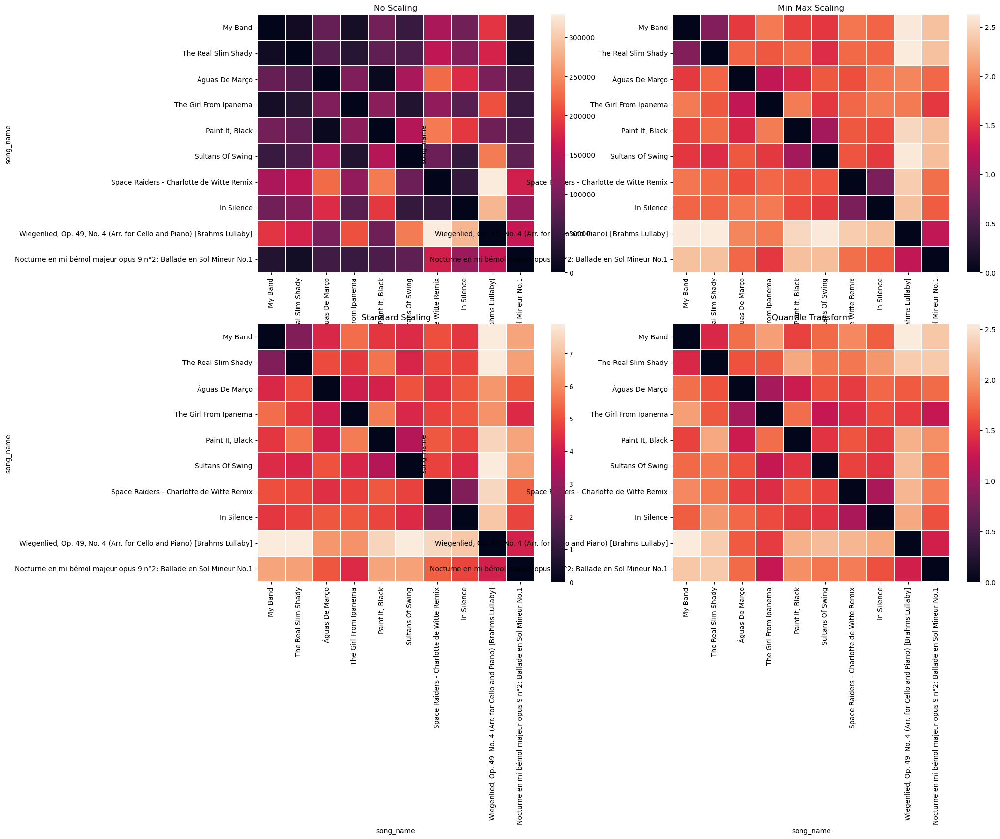

In [114]:

fig, ax = plt.subplots(2, 2, figsize=(20, 15))

sns.heatmap(no_scaled_dist, ax = ax[0,0], linewidths=.2);
sns.heatmap(minmax_scaled_df_dist, ax = ax[0,1], linewidths=.2);
sns.heatmap(std_scaled_df_dist, ax = ax[1,0], linewidths=.2);
sns.heatmap(qt_scaled_df_dist, ax = ax[1,1], linewidths=.2);



# Adding titles to the plots
ax[0,0].set_title('No Scaling')
ax[0,1].set_title('Min Max Scaling')
ax[1,0].set_title('Standard Scaling')
ax[1,1].set_title('Quantile Transform')


plt.show()

In [ ]:
# manual clustering
# https://open.spotify.com/playlist/2WyxU9mT4S1XhBnQva7Jkt?si=2ef3cbca30aa4661&nd=1



In [251]:
dfk = pd.read_csv('~/Documents/datacamp/WBS-School/moosic/df_audio_features_1000.csv')

# dfk.head()

In [252]:
dfk.drop(['name','artist','id','html','type','mode'], axis=1, inplace=True)


In [253]:
# std_scaled_df.dropna(inplace=True)
# std_scaled_df.replace([np.inf, -np.inf], np.nan, inplace=True)


In [254]:
dfk = dfk.reset_index()
# dfk = dfk.set_index(['name'])
print(dfk.index.values)


[   0    1    2 ... 1437 1438 1439]


In [255]:
# https://stackoverflow.com/questions/14861891/runtimewarning-invalid-value-encountered-in-divide
# import numpy as np
# np.seterr(divide='ignore', invalid='ignore')

In [268]:
# apply Scaler
std_scaledk = StandardScaler().fit_transform(dfk)
std_scaled_dfk = pd.DataFrame(std_scaledk, columns=dfk.columns, index=dfk.index)

minmax_scaledk = MinMaxScaler().fit_transform(dfk)
minmax_dfk = pd.DataFrame(minmax_scaledk, columns=dfk.columns, index=dfk.index)


quantile_dfk = QuantileTransformer(n_quantiles=len(dfk.iloc[:,-1])).fit_transform(dfk)

qt_scaled_dfk = pd.DataFrame(quantile_dfk, columns=dfk.columns, index=dfk.index)




In [257]:
# std_scaled_df.info()

In [258]:
minmax_dfk

,index,danceability,energy,key,loudness,speechiness,acousticness,instrumentalness,liveness,valence,tempo,duration_ms,time_signature
0,0.000000,0.624060,0.469869,0.909091,0.708800,0.196816,0.884538,0.000006,0.127865,0.965817,0.156106,0.014474,0.75
1,0.000695,0.580938,0.247977,0.090909,0.698907,0.030391,0.453814,0.000009,0.089495,0.591879,0.494567,0.042899,0.75
2,0.001390,0.254755,0.227896,0.272727,0.689059,0.014291,0.947791,0.000081,0.618376,0.211726,0.412383,0.025189,0.75
3,0.002085,0.531181,0.683728,0.363636,0.856565,0.049928,0.811245,0.000000,0.146531,0.802155,0.247063,0.065093,0.75
4,0.002780,0.437196,0.167654,0.000000,0.676903,0.091715,0.921687,0.000000,0.157938,0.398177,0.168742,0.032589,0.75
...,...,...,...,...,...,...,...,...,...,...,...,...,...
1435,0.997220,0.157452,0.069660,0.272727,0.461981,0.043596,0.920683,0.725888,0.064814,0.047545,0.244005,0.248397,0.75
1436,0.997915,0.141973,0.101387,0.545455,0.495329,0.037988,0.858433,0.432487,0.050503,0.016470,0.213537,0.211094,0.75
1437,0.998610,0.000000,0.000913,0.818182,0.031808,0.036541,0.954819,0.983756,0.058592,0.015330,0.139723,0.046743,0.50
1438,0.999305,0.081159,0.020864,0.363636,0.328922,0.033828,0.886546,0.512690,0.093643,0.040916,0.111222,0.067026,0.75


In [259]:
# https://stackoverflow.com/questions/53421626/valueerror-found-array-with-0-sample-s-shape-0-1-while-a-minimum-of-1-is



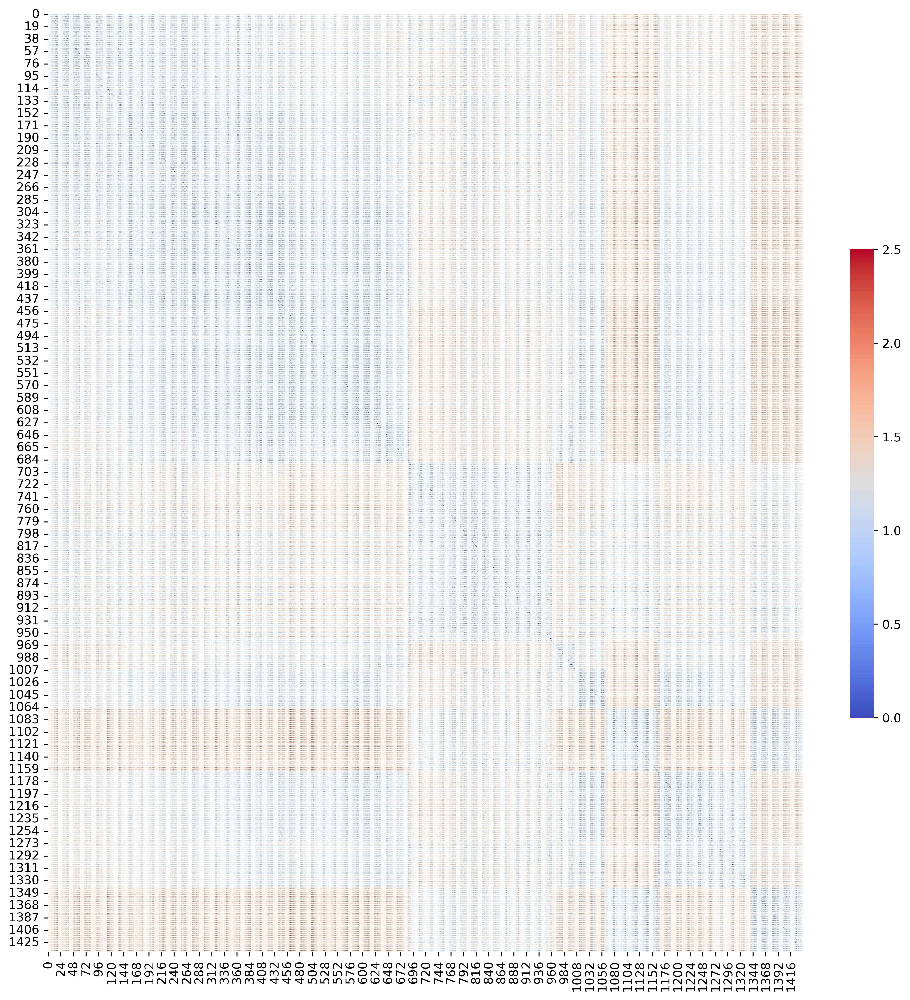

In [264]:

# minmax scaled
# we notice around 3 groups of coloring distinctly
dataf = minmax_dfk
dist_df1 = pd.DataFrame(pairwise_distances(dataf), index=dataf.index, columns=dataf.index)


plt.figure(figsize=(14,14),dpi=600)

sns.heatmap(dist_df1, linewidths=.2,cbar_kws={"shrink": 0.5},cmap='coolwarm');


plt.show()

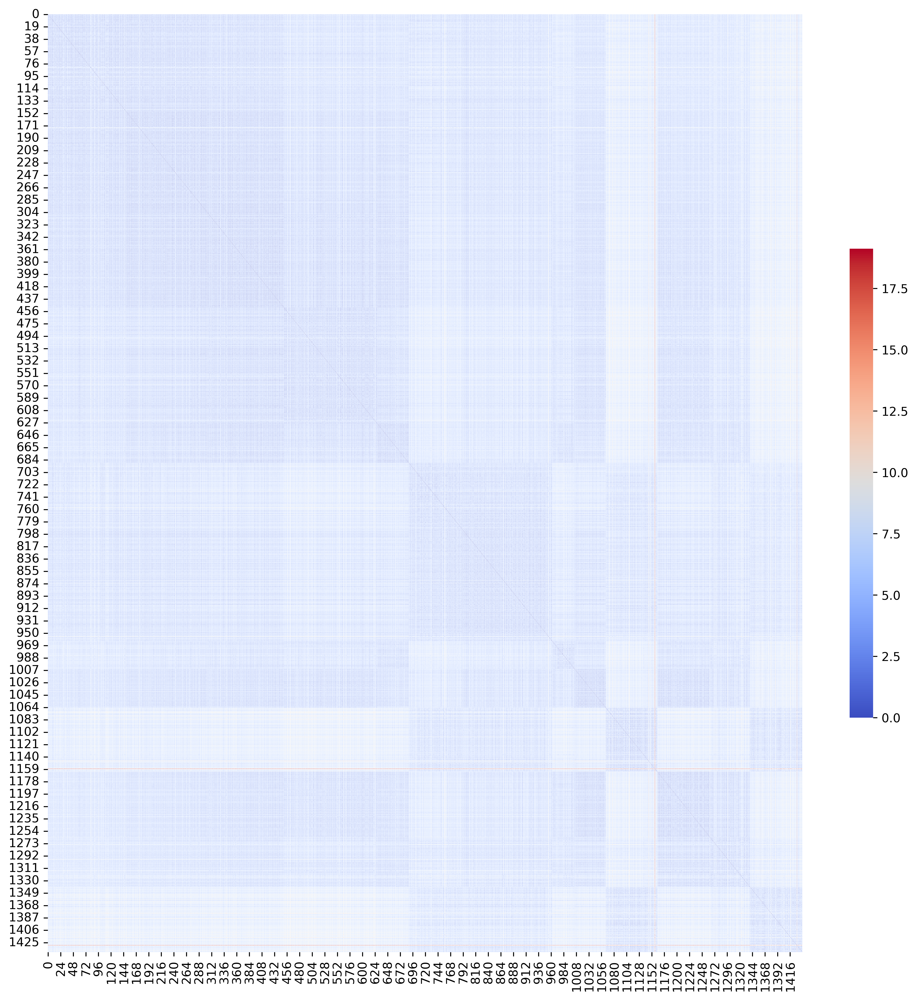

In [265]:
# standard scaled
# color groups not distinct
dataf = std_scaled_dfk
dist_df2 = pd.DataFrame(pairwise_distances(dataf), index=dataf.index, columns=dataf.index)

plt.figure(figsize=(14,14),dpi=600)

sns.heatmap(dist_df2, linewidths=.2,cbar_kws={"shrink": 0.5},cmap='coolwarm');


plt.show()



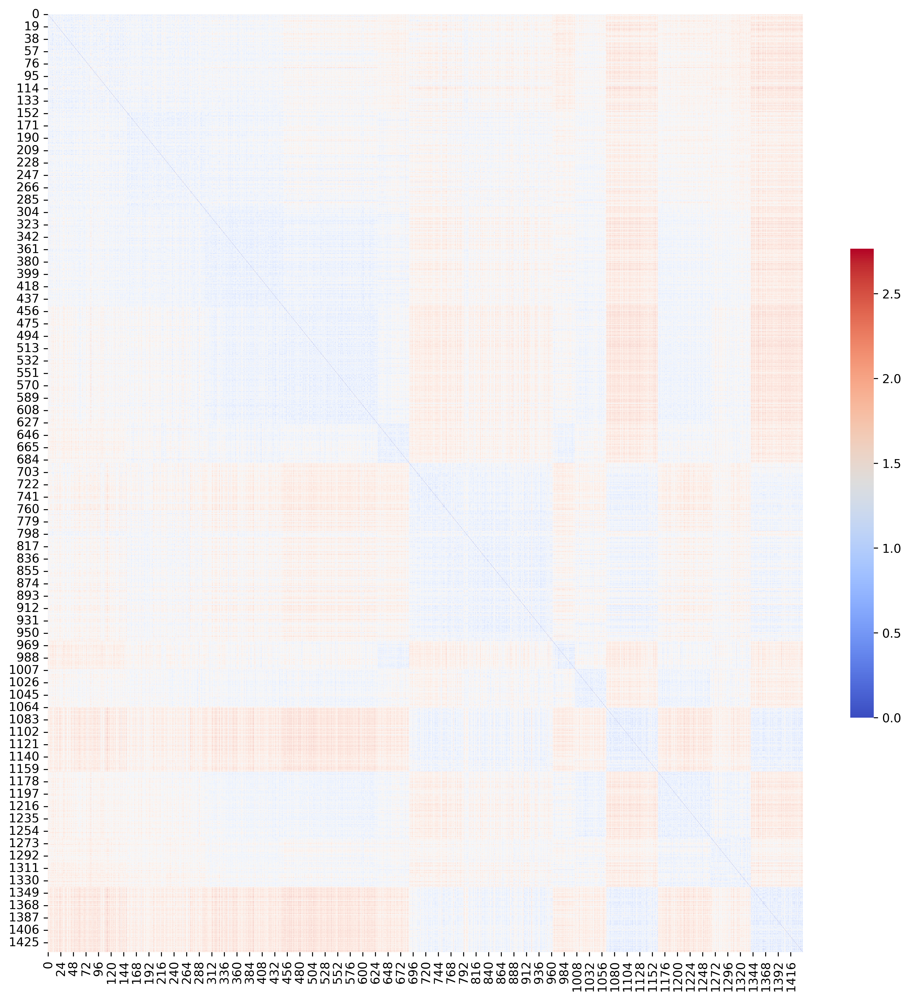

In [269]:
# quantile scaled
# color groups 3 but opaque/unclear
dataf = qt_scaled_dfk
dist_df3 = pd.DataFrame(pairwise_distances(dataf), index=dataf.index, columns=dataf.index)

plt.figure(figsize=(14,14),dpi=600)

sns.heatmap(dist_df3, linewidths=.2,cbar_kws={"shrink": 0.5},cmap='coolwarm');


plt.show()

### After visualization, we can inspect the emergence of distinct clusters
### but further inference becomes limited
- cluster count : 3
- next step : labeling

In [ ]:
# normalization scales your values between a minimum and maximum value

In [ ]:
# Use MinMaxScaler() to scale the data.
# Use Matplotlib or Pandas to plot the distributions of all the variables. 
# Are the distributions skewed? Are there outliers?
# plot the distributions of the features after each transformation 
# to explore how the data looks like. 
# Try using a different transformer to scale the data. 
# StandardScaler()
# RobustScaler()
# QuantileTransformer()

In [9]:
df5k_v0 = pd.read_csv('~/Documents/datacamp/WBS-School/moosic/df_audio_features_5000.csv')

# df5k.info()
df5k = df5k_v0.copy()

In [10]:
# df5k.head(5)

In [11]:
# remove whitespace from column labels
df5k.columns = df5k.columns.str.replace(' ', '')
df5k_v0.columns = df5k_v0.columns.str.replace(' ', '')


In [12]:
feature_ls = ['danceability','speechiness','energy','valence','liveness','acousticness','instrumentalness','tempo','duration_ms','cluster']
drop_ls = [x for x in df5k.columns if x not in feature_ls]
print(drop_ls)
df5k.drop(drop_ls, axis=1, inplace=True)
# df5k.drop(['name','artist','mode','type','id','html'], axis=1, inplace=True)
df5k

['name', 'artist', 'key', 'loudness', 'mode', 'type', 'time_signature', 'id', 'html']


,danceability,energy,speechiness,acousticness,instrumentalness,liveness,valence,tempo,duration_ms
0,0.6580,0.25900,0.0705,0.694,0.000059,0.9750,0.3060,110.376,256213
1,0.7420,0.39900,0.0346,0.217,0.000002,0.1070,0.6930,125.039,191867
2,0.8510,0.73000,0.3470,0.453,0.000063,0.1240,0.9050,93.698,152267
3,0.7050,0.05020,0.0471,0.879,0.000041,0.3860,0.5240,106.802,186227
4,0.6510,0.11900,0.0380,0.916,0.000343,0.1040,0.4020,120.941,273680
...,...,...,...,...,...,...,...,...,...
5230,0.2020,0.06940,0.0473,0.917,0.715000,0.0832,0.0655,87.906,995000
5231,0.1880,0.10100,0.0442,0.855,0.426000,0.0694,0.0355,83.134,855000
5232,0.0596,0.00093,0.0434,0.951,0.969000,0.0772,0.0344,71.573,238187
5233,0.1330,0.02080,0.0419,0.883,0.505000,0.1110,0.0591,67.109,314307


In [13]:
# scaling
# minmax provides distinct groups per 1k sample
minmax_scaled5k = MinMaxScaler().fit_transform(df5k)

# try other scaling method (quantile)

In [14]:
from sklearn.cluster import KMeans



In [15]:
# elbow method

inertia_keys = list(range(1, 30))
inertia_list = []
for c in range(1,30):
    km = KMeans(n_clusters=c)
    km.fit(minmax_scaled5k)
    inertia_list.append(round(km.inertia_))
inertia_dc = dict(zip(inertia_keys,inertia_list))
print(inertia_dc)

{1: 2779, 2: 1834, 3: 1235, 4: 984, 5: 798, 6: 734, 7: 685, 8: 651, 9: 618, 10: 596, 11: 575, 12: 555, 13: 538, 14: 523, 15: 509, 16: 497, 17: 486, 18: 475, 19: 469, 20: 458, 21: 451, 22: 444, 23: 435, 24: 429, 25: 422, 26: 415, 27: 410, 28: 406, 29: 399}


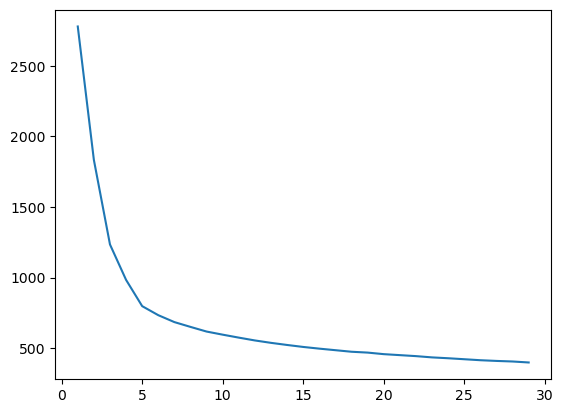

In [16]:
# elbow plot
# observation: k = 4
plt.plot(inertia_keys, inertia_list)
plt.show()

In [17]:
# silhouette score
# from sklearn.metrics import silhouette_score

# silhouette_keys = list(range(1, 30))
# silhouette_list = []
# for c in range(1,30):
#     km = KMeans(n_clusters=c)
#     sc = silhouette_score(df5k,km.labels_)
#     silhouette_list.append(round(sc))
# print(silhouette_list)


In [18]:
# generate model
clusters = 5
km = KMeans(n_clusters=clusters)
km.fit(df5k)
clust_se = km.predict(df5k)
df5k['cluster'] = clust_se
# display(df5k.head(5))

In [19]:
df5k.max()['cluster'] # max cluster numbers

4.0

In [514]:
# Cluster exploration:
# Univariate
# Plotting the distribution of an individual feature (such as “energy”) across different clusters.
# Visualizing the clusters in a scatterplot with two different features.


In [20]:
# analyse features
df5k.columns.values
dims = list(df5k.columns.values)
print(dims)
dimension = dims[1]

['danceability', 'energy', 'speechiness', 'acousticness', 'instrumentalness', 'liveness', 'valence', 'tempo', 'duration_ms', 'cluster']


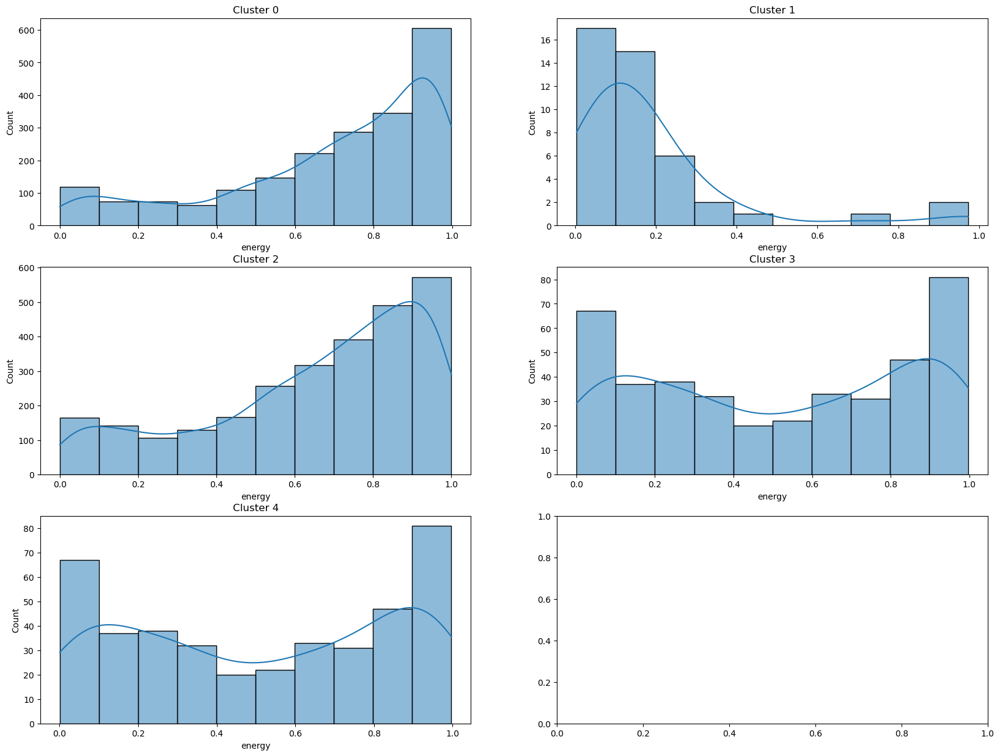

In [21]:


fig, ax = plt.subplots(3, 2, figsize=(20, 15))

# cluster 0 energy distribution
c0 = df5k.loc[df5k['cluster']==0][dimension]
c1 = df5k.loc[df5k['cluster']==1][dimension]
c2 = df5k.loc[df5k['cluster']==2][dimension]
c3 = df5k.loc[df5k['cluster']==3][dimension]
c3 = df5k.loc[df5k['cluster']==4][dimension]

sns.histplot(data=c0, bins=10, kde=True,ax=ax[0,0])
sns.histplot(data=c1, bins=10, kde=True,ax=ax[0,1])
sns.histplot(data=c2, bins=10, kde=True,ax=ax[1,0])
sns.histplot(data=c3, bins=10, kde=True,ax=ax[1,1])
sns.histplot(data=c3, bins=10, kde=True,ax=ax[2,0])

# Adding titles to the plots
ax[0,0].set_title('Cluster 0')
ax[0,1].set_title('Cluster 1')
ax[1,0].set_title('Cluster 2')
ax[1,1].set_title('Cluster 3')
ax[2,0].set_title('Cluster 4')


plt.show()

In [586]:
# scatter plot for one dimension 
# print(df5k[dimension])

/Users/cytalladen/opt/anaconda3/lib/python3.9/site-packages/seaborn/categorical.py:1296: UserWarning: 79.9% of the points cannot be placed; you may want to decrease the size of the markers or use stripplot.
  warnings.warn(msg, UserWarning)
/Users/cytalladen/opt/anaconda3/lib/python3.9/site-packages/seaborn/categorical.py:1296: UserWarning: 74.6% of the points cannot be placed; you may want to decrease the size of the markers or use stripplot.
  warnings.warn(msg, UserWarning)
/Users/cytalladen/opt/anaconda3/lib/python3.9/site-packages/seaborn/categorical.py:1296: UserWarning: 13.0% of the points cannot be placed; you may want to decrease the size of the markers or use stripplot.
  warnings.warn(msg, UserWarning)


<AxesSubplot:xlabel='cluster', ylabel='energy'>

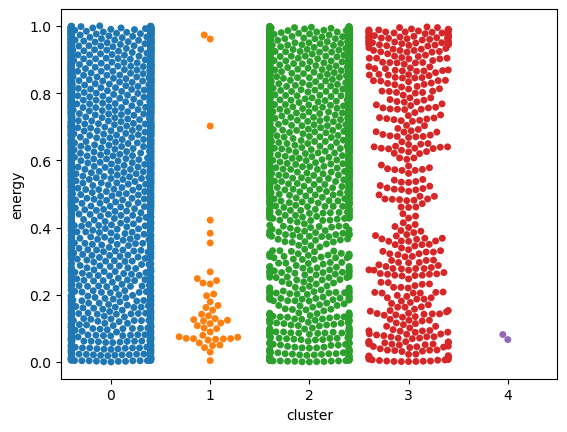

In [587]:
# sns.scatterplot(x=df5k.cluster,y=df5k[dimension])
# sns.stripplot(x=df5k.cluster,y=df5k[dimension])
sns.swarmplot(x=df5k.cluster,y=df5k[dimension])

In [589]:
# labeling df with song names
df5k_v0['cluster'] = df5k['cluster']


1.0 0.539 0.0


/var/folders/qk/tw9hw7y536n3q312492k3k3m0000gn/T/ipykernel_87012/3017967596.py:17: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  to_plot['cluster'] = df5k['cluster']


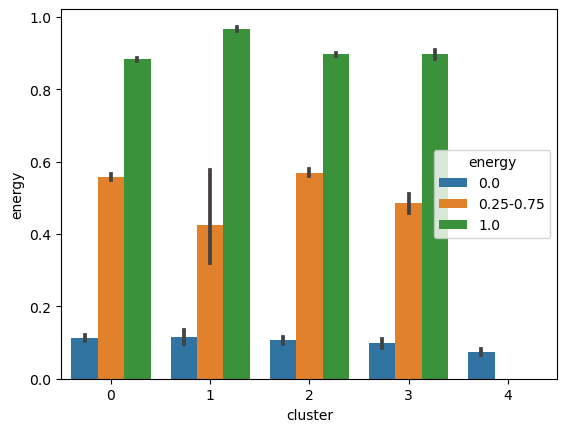

In [607]:
# plotting subgroups
# https://stackoverflow.com/questions/65119003/binning-pandas-value-counts
max = df5k_v0[dimension].max()
q3 = df5k_v0[dimension].max() * .75
q2 = df5k_v0[dimension].max() * .25
min = df5k_v0[dimension].min()
print(f'{max} {med} {min}')
# bin_ls = list(df5k_v0[dimension].value_counts(bins = [min,q2,q3,max], sort = False)))
# print(df5k_v0[dimension])
# prop_df = df5k_v0[['name',dimension]]
# display(prop_df)
bins = [min,q2,q3,max]
group_names=[str(min),str(q2)+'-'+str(q3),str(max)]
to_plot = pd.DataFrame(index=df5k_v0['name'])
to_plot.reset_index(inplace=True)
to_plot = df5k_v0['name']
to_plot['cluster'] = df5k['cluster']
# to_plot.set_index('name')
to_plot[dimension] = df5k[dimension]
to_plot['bins']=pd.cut(df5k[dimension],bins,labels=group_names)

sns.barplot(data=to_plot,x='cluster',y=dimension,hue='bins')
plt.show()

In [ ]:
# https://www.kaggle.com/code/yugagrawal95/k-means-clustering-using-seaborn-visualization
sns.countplot(x='year',hue='brand',data=df)


<AxesSubplot:xlabel='danceability', ylabel='tempo'>

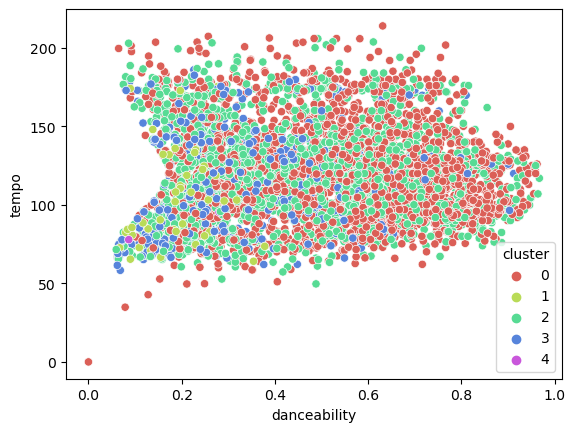

In [588]:
# 2-dimension scatterplot (bivariate)
sns.scatterplot(x='danceability',y='tempo',hue='cluster',palette=sns.color_palette("hls",clusters),data=df5k,legend="full")



In [1]:
sns.pairplot(df5k)

NameError: name 'sns' is not defined

In [496]:
# manual verficiation of features per cluster
df5k_v0.loc[df5k_v0['cluster']==0][['name','artist','html','cluster']].sample(5).sample(5)


,name,artist,html,cluster
3002,To Ü (feat. AlunaGeorge) ...,Jack Ü,https://open.spotify.com/track/3UgSQu6WwrXfKKD...,0
3694,Fermented Offal Discharge ...,Necrophagist,https://open.spotify.com/track/3RMXNhAwmWnPy90...,0
2095,"Piano Trio No. 3 in C Minor, Op. 101: Andante ...",Johannes Brahms,https://open.spotify.com/track/08JqZxMgLW6Y8vy...,0
4907,Schwung in die Kiste ...,Die Orsons,https://open.spotify.com/track/1d0LKskvREPlQfB...,0
2125,Flower Through Concrete ...,Chloe Flower,https://open.spotify.com/track/4xV7soqf9cp13VB...,0


In [494]:
df5k_v0.loc[df5k_v0['cluster']==2][['name','artist','html','cluster']].sample(5).sample(5)


,name,artist,html,cluster
769,Black Magic ...,Little Mix,https://open.spotify.com/track/7FtLZygO3k5bz49...,2
568,Señorita ...,Shawn Mendes,https://open.spotify.com/track/6v3KW9xbzN5yKLt...,2
4082,The Call ...,Necrophobic,https://open.spotify.com/track/7aSv7dmCozRb20i...,2
2741,Red Lips (feat. Sam Bruno) - Skrillex Remix ...,Good Times Ahead,https://open.spotify.com/track/6mNMp0g3zkg1K7u...,2
3058,Forever (feat. will.i.am) - Radio Edit ...,Wolfgang Gartner,https://open.spotify.com/track/1w2DvboqPHfVTch...,2


In [495]:
df5k_v0.loc[df5k_v0['cluster']==4][['name','artist','html','cluster']].sample(5)


,name,artist,html,cluster
4592,Freeze ...,Klaus Schulze,https://open.spotify.com/track/5mHtUWgWPJ2Oi24...,4
2603,"A Love Supreme, Pt. IV - Psalm ...",John Coltrane,https://open.spotify.com/track/5FLQmLjjeNIuC8U...,4
4591,Plateau ...,The Orb,https://open.spotify.com/track/3B4lp8GZOzyvpNe...,4
2438,"Die Zauberflöte, K.620: Overture ...",Wolfgang Amadeus Mozart,https://open.spotify.com/track/6xBpeJHE26gAAjg...,4
5142,"Symphony No. 9 in E Minor, Op. 95, B. 178, ""Fr...",Antonín Dvořák,https://open.spotify.com/track/0hBoe0lGBmDbGpC...,4


In [493]:
df5k_v0.loc[df5k_v0['cluster']==1][['name','artist','html','cluster']].sample(5)



,name,artist,html,cluster
5218,Symphony No. 1: I. Presto ...,Peter Maxwell Davies,https://open.spotify.com/track/1IkHBX9h5Eld9z4...,1
5215,Lontano ...,György Ligeti,https://open.spotify.com/track/2ehEZK4uxSDNdFQ...,1
4604,Ferrum ...,Chihei Hatakeyama,https://open.spotify.com/track/0s5x2cr3VyJYez1...,1
5183,Symphony No. 3 ...,Polish National Radio Symphony Orchestra,https://open.spotify.com/track/2dIpMRSyCUTT0d5...,1
4589,A Rainbow in the Curved Air - Instrumental ...,Terry Riley,https://open.spotify.com/track/0aGvcIUEdMq9Pel...,1


In [497]:
df5k_v0.loc[df5k_v0['cluster']==3][['name','artist','html','cluster']]


,name,artist,html,cluster
4600,dlp 1.1 ...,William Basinski,https://open.spotify.com/track/31FiS1jMI38kYfC...,3
5224,Symphony No. 6 ...,Allan Pettersson,https://open.spotify.com/track/1HB8dwgqku7790A...,3


In [ ]:
# cluster labeling (genre)

# cluster 0 : playlist 1
# cluster 1 : playlist 2
# cluster 2 : playlist 3
# cluster 3 : playlist 4
# cluster 4 : playlist 5

### Business questions

1. Are Spotify's audio features able to identify 'similar songs', as defined by humanly detectable criteria?
There are non-human detectable features that could be relevant to classification (bpm, acoustics, background beats)


2. Is K-Means a good method to create playlists?
Drawbacks of kmeans for classification use cases

In [ ]:
# k-means is a good start for preprocessing data with high number of dimensions
# further analysis of dimensions should be considered
# large clusters requires further subgrouping
# distinct clusters vs proportional subgrouping of distinct range of dimension
# 
# kmeans cannot create playlists due to its nature of grouping items
# using distance between tuples as a classification method
# its possible to create playlists with more sophisticated classification methods

